# Predicting the Next Spotify Hit

Austin Leung & Ivana Lin

### Motivation
Our project was inspired by a New York Times [article](https://www.nytimes.com/2021/03/22/technology/streaming-music-economics.html) about the economics of music streaming. It detailed how streaming changed the music industry because it provided regular monthly revenue, something the industry never experienced before the likes of Spotify came around. The article goes on to discuss the inequity in how streaming revenue is shared between the platform, record labels, and artists themselves. However, it was clear from the overall article that a lot of money is at stake for both record labels and artists if they can make a hit song that gets a lot of streams. This inspired us to investigate what audio features can lead to a popular song since such information would massively benefit record labels and artists in terms of generating income from the art they make.

Additionally, we also saw another [article](https://www.buzzfeednews.com/article/blakemontgomery/spotify-billboard-charts) by Buzzfeed News which comments on how charting on places like the Billboard chart is affected by streaming popularity. The more streams a song gets on platforms like Spotify and Apple Music, the more likely the song is to chart higher. Such recognition in turn brings in revenue for record labels along with branding and exposure for artists trying to make a name for themselves.

Given that Spotify has 345 million users, including 155 million paid subscribers, predicting song popularity on Spotify is massively important for record labels and artists. If it's possible to discern the musical tastes of users on Spotify, producers can leverage the number of Spotify users and the potential for streams by writing songs they know will be popular. This provides labels and artists a way to advertise their music and increase how much they make from their songs. In light of how the pandemic has affected our daily lives, this study is especially relevant since COVID-19 has exposed how volatile the economics of the music industry are. Without physical concerts and performances, revenue in the music industry has been gutted, but streaming has been what has saved the music industry. As such, we plan to explore predicting song popularity from audio features not only because of an interest in increasing revenue for record labels and artists, but also so that they can maintain a steady flow of income in an extremely volatile industry.

### Dataset Information

The [dataset](https://www.kaggle.com/yamaerenay/spotify-dataset-19212020-160k-tracks?select=data.csv) we are using is from Kaggle. It describes songs on Spotify collected from the Spotify Web API and the songs range from being released in 1921 to 2021. All the data we will use is in 1 file and 1 table with 174389 rows of data. The dataset has 19 columns and according to the data dictionary, they are as follows:
- id (Id of track generated by Spotify)
- acousticness (Ranges from 0 to 1)
- danceability (Ranges from 0 to 1)
- energy (Ranges from 0 to 1)
- duration_ms (Integer typically ranging from 200k to 300k)
- instrumentalness (Ranges from 0 to 1)
- valence (Ranges from 0 to 1)
- popularity (Ranges from 0 to 100)
- tempo (Float typically ranging from 50 to 150)
- liveness (Ranges from 0 to 1)
- loudness (Float typically ranging from -60 to 0)
- speechiness (Ranges from 0 to 1)
- mode (0 = Minor, 1 = Major)
- explicit (0 = No explicit content, 1 = Explicit content)
- key (All keys on octave encoded as values ranging from 0 to 11, starting on C as 0, C# as 1 and so on…)
- artists (List of artists mentioned)
- release_date (Date of release mostly in yyyy-mm-dd format, however precision of date may vary)
- year (Year that the song was released)
- name (Name of the song)

Given that each variable forms a column and each observation forms a row, we can see that the data is tidy, however, it is not clean. Most of the columns are the correct data type but artists is stored as a list and is not atomic. We will likely be dropping this column anyway since the value of our study comes from predicting how to write and produce a popular song and artist will be a confounding variable since popularity may be from the artist and not necessarily because people like the sound of the song. The data also has categorical variables like whether or not it’s an explicit song so we will need to one hot encode them in order to run ML algorithms on the data. Ultimately, the variables we will be using from the dataset are popularity and the audio features like acousticness, energy, etc.

### Data Loading and Cleaning

In [ ]:
import pandas as pd

In [ ]:
df = pd.read_csv('data.csv')
df.shape

(174389, 19)

We see that we have 174389 rows and 19 columns of data.

In [ ]:
df.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,11m7laMUgmOKqI3oYzuhne,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,19Lc5SfJJ5O1oaxY0fpwfh,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,2hJjbsLCytGsnAHfdsLejp,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


In [ ]:
df.dtypes

acousticness        float64
artists              object
danceability        float64
duration_ms           int64
energy              float64
explicit              int64
id                   object
instrumentalness    float64
key                   int64
liveness            float64
loudness            float64
mode                  int64
name                 object
popularity            int64
release_date         object
speechiness         float64
tempo               float64
valence             float64
year                  int64
dtype: object

All of the column types seem reasonable so far. Note that explicit, key, and mode record categorical variables as dummy/indicator variables. Thus they need to be one-hot encoded later in our ML pipeline in order to prevent the ML algorithms from making false correlations based on the relative proximity of ordered values.

In [ ]:
df.isnull().values.any()

False

In [ ]:
df.isna().sum()

acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
valence             0
year                0
dtype: int64

We see that there are no null values to clean up!

Now to select which features we want to keep for our model. We decided to exclude the following features:
- `artists`: Some highly popular artists would have consistently popular songs which isn't what our model is aiming to identify.
- `name`: Each song's name is almost guaranteed to vary which would not be helpful for our model.
- `release_date`/`year`: The year of a song isn't very helpful as more recent songs will likely be more popular on Spotify now and we can't control what year a song is released in the future. From release date, we hoped to extract the month and day of week which definitely could have implications for future song releases, but around half of the dataset doesn't have an exact date for `release_date` which makes dropping those songs not worth it.
- `id`: This is a unique identifier for Spotify that would be unique for each song.


In [ ]:
df = df.drop(columns=['artists', 'name', 'release_date', 'year', 'id'])
df.shape

(174389, 14)

After dropping the features we don't need, we still have 174389 rows, but now we have only 14 columns in our data.

In [ ]:
df.duplicated().value_counts()

False    170191
True       4198
dtype: int64

We see now that id is gone, there seems to be some duplicated rows! After dropping these duplicate rows, we still have 170191 rows and 14 columns of data.

In [ ]:
df = df.drop_duplicates()
df.shape

(170191, 14)

Finally, we verify that our data is clean by checking the first few rows of our dataframe and the datatypes of each column.

In [ ]:
df.head()

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence
0,0.991000,0.598,168333,0.224,0,0.000522,5,0.3790,-12.628,0,12,0.0936,149.976,0.6340
1,0.643000,0.852,150200,0.517,0,0.026400,5,0.0809,-7.261,0,7,0.0534,86.889,0.9500
2,0.993000,0.647,163827,0.186,0,0.000018,0,0.5190,-12.098,1,4,0.1740,97.600,0.6890
3,0.000173,0.730,422087,0.798,0,0.801000,2,0.1280,-7.311,1,17,0.0425,127.997,0.0422
4,0.295000,0.704,165224,0.707,1,0.000246,10,0.4020,-6.036,0,2,0.0768,122.076,0.2990


In [ ]:
df.dtypes

acousticness        float64
danceability        float64
duration_ms           int64
energy              float64
explicit              int64
instrumentalness    float64
key                   int64
liveness            float64
loudness            float64
mode                  int64
popularity            int64
speechiness         float64
tempo               float64
valence             float64
dtype: object

Now that our data is clean, we split the dataset into test and train datasets.

In [ ]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, test_size=0.2)

### Exploratory Data Analysis

In order to get an idea of what features may be effective in predicting song popularity, we perform some exploratory data analysis. First, we want to examine our response variable. Below we see some summary information about song popularity in the dataset.

In [ ]:
train['popularity'].describe()

count    136152.000000
mean         26.209927
std          21.811256
min           0.000000
25%           2.000000
50%          26.000000
75%          43.000000
max         100.000000
Name: popularity, dtype: float64

We see that both the mean and median popularity is around 26, so roughly half of the songs in the dataset are not particularly popular.

In [ ]:
import altair as alt
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [ ]:
pop = train[['popularity']]
alt.Chart(pop).mark_bar().encode(
    alt.X("popularity:Q", bin=True),
    y='count()',
).properties(
    title="Popularity has a Positive Skew"
)

alt.Chart(...)

We can also see that the distribution of popularity has a positive skew, which is consistent with the summary information. Most of the records in the data are songs that have a relatively low popularity value.

Next, we examine each of our numerical predictor variables to see how they are distributed.

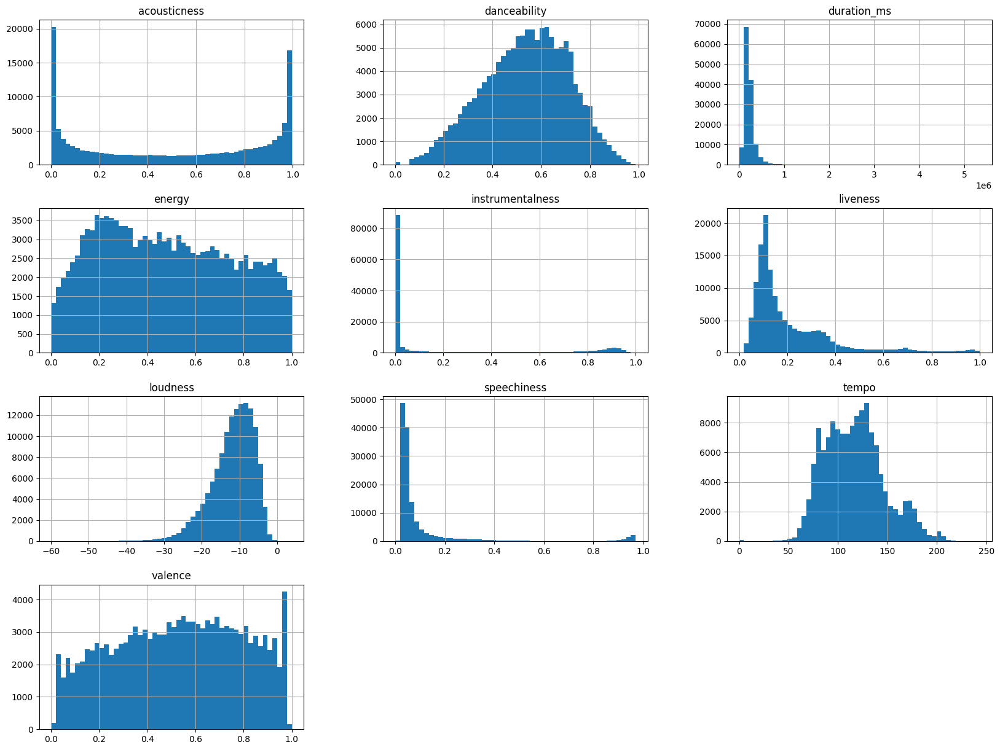

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
numerical = ['acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 
'tempo', 'valence']
train[numerical].hist(bins=50, figsize=(20,15))
plt.show()

We observe that duration, instrumentalness, liveliness, and speechiness are all skewed. Their distributions extend farther to the right of the median than to the left, which may make it harder for ML algorithms to detect patterns. We may need to transform these attributes later to have more bell-shaped distributions.

Additionally, we note that for both instrumentalness and speechiness, there appear to be a group of data points very far to the right of the rest of the data. They seem like they may be outliers, but judging by the number of such data points, they may be naturally occurring outliers that are important for the problem.

After examining our quantitative variables, we then explore how our categorical variables are distributed. The boxplots for mode are very similar, but the boxplots for explicit differ in that the IQR and the median for explicit songs are both larger than those for non-explicit songs.

We can also see that there is little difference in the boxplots for key, but there is an outlier that we may be wary of. This outlier should not be too concerning, however, given the nature of our data to be skewed in terms of popularity. As we saw earlier, the dataset contains more data points about songs with relatively low popularity than more popular songs.

In [ ]:
explicit = train[['popularity', 'explicit']]
key = train[['popularity', 'key']]
mode = train[['popularity', 'mode']]

exp_box = alt.Chart(explicit).mark_boxplot().encode(
    x='explicit:N',
    y='popularity:Q'
)

key_box = alt.Chart(key).mark_boxplot().encode(
    x='key:N',
    y='popularity:Q'
)

mode_box = alt.Chart(mode).mark_boxplot().encode(
    x='mode:N',
    y='popularity:Q'
)

exp_box | key_box | mode_box

alt.HConcatChart(...)

Before we examine each feature's relationship with popularity, we would like to understand each feature's relationship with each other.

In [ ]:
features = ['acousticness', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'valence']
train_features = train[features]
feature_corrs = train_features.corr()

# Correlation heatmap inspired by https://towardsdatascience.com/altair-plot-deconstruction-visualizing-the-correlation-structure-of-weather-data-38fb5668c5b1

cor_data = (train_features
              .corr().stack()
              .reset_index()     # The stacking results in an index on the correlation values, we need the index as normal columns for Altair
              .rename(columns={0: 'correlation', 'level_0': 'Feature 1', 'level_1': 'Feature 2'}))
cor_data = cor_data[cor_data['Feature 1'] < cor_data['Feature 2']] # only generate half the matrix
cor_data['correlation_label'] = cor_data['correlation'].map('{:.2f}'.format) 

base = alt.Chart(cor_data).encode(
    x='Feature 1:O',
    y='Feature 2:O'    
)

text = base.mark_text().encode( # corr labels
    text='correlation_label',
    color=alt.condition( # readability
        alt.datum.correlation > 0.5, 
        alt.value('white'),
        alt.value('black')
    ),
)

# Heatmap
cor_plot = base.mark_rect().encode(
    color=alt.Color('correlation:Q', scale=alt.Scale(domain=(-1, 1), scheme='redblue'))
)

cor_matrix = (cor_plot + text).properties(
    title='Only a few feature pairs are strongly correlated',
    width=400,
    height=400
)

cor_data['Pair of features'] = cor_data['Feature 1'] + ' & ' + cor_data['Feature 2']
cor_data['Absolute value of correlation'] = cor_data['correlation'].abs()

base_bars = alt.Chart(cor_data).mark_bar().encode(
    x=alt.X('Absolute value of correlation:Q', scale=alt.Scale(domain=(0, 1)), axis=alt.Axis(title='Absolute value of correlation ( > 0.25)')),
    y=alt.Y('Pair of features:O', sort='-x'),
).transform_filter(
    (abs(alt.datum.correlation) > 0.25)
).properties(
    title='Acousticness, Loudness, and Energy share the strongest correlations',
    width=400,
    height=400
)

# mark colors of bars, but independent of color of text labels below
bars = base_bars.mark_bar().encode(
    color=alt.condition(
        abs(alt.datum.correlation) > 0.5,  # If abs(correlation) is above 0.5
        alt.value('steelblue'),  # highlight bar as dark blue
        alt.value('lightblue')   # default color
    )
)

text = base_bars.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    color='black'
).encode(
    text=alt.Text('correlation:Q', format=',.2r')
)

# Display viz side by side
alt.vconcat(
    cor_matrix, bars + text
).resolve_scale( # move legend with the correlation matrix
    color='independent' 
)

alt.VConcatChart(...)

We observe that most features aren't strongly correlated, which will give stronger weight to our model's findings. However, there are four pairs of features that have a correlation absolute value greater than 0.5. In particular, any results involving Energy, Loudness, and Acousticness will need to be given extra scrutiny since multicollinearity could be a risk for our model.

Next, we examine the predictor variables and their relationship with popularity.

In [ ]:
corr_popularity = train[features].corrwith(train['popularity'])
corr_popularity_df = corr_popularity.to_frame().reset_index().rename(columns={0: 'correlation'})
corr_popularity_df['Absolute Value of Correlation with Popularity'] = corr_popularity_df['correlation'].abs()

base_bars = alt.Chart(corr_popularity_df).mark_bar().encode(
    x=alt.X('Absolute Value of Correlation with Popularity:Q', scale=alt.Scale(domain=(0, 1))),
    y=alt.Y('index:O', axis=alt.Axis(title='Audio Feature'), sort='-x')
).properties(
    title='Acousticness, Loudness, and Energy also have the strongest correlations with Popularity',
    width=500,
    height=400
)

bars = base_bars.mark_bar().encode(
    color=alt.condition(
        abs(alt.datum['Absolute Value of Correlation with Popularity']) > 0.3,  # If abs(correlation) is above 0.2
        alt.value('steelblue'),  # highlight bar as dark blue
        alt.value('lightblue')   # default color
    )
)

text = base_bars.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    color='black'
).encode(
    text=alt.Text('correlation:Q', format=',.2r')
)

bars + text

alt.LayerChart(...)

We see that overall correlation with popularity isn't very strong. However, the same three features that were correlated with each other—acousticness, loudness, and energy—are most strongly correlated with popularity. These features should certainly be kept an eye on with our model given these indications that they might be influential features.

From the above graph, we see that the top 5 attributes most correlated with popularity are acousticness, loudness, energy, instrumentalness, and speechiness. In order to get a better idea of each predictor variable's relationship with popularity, we produce some scatterplots between these 5 attributes and popularity.

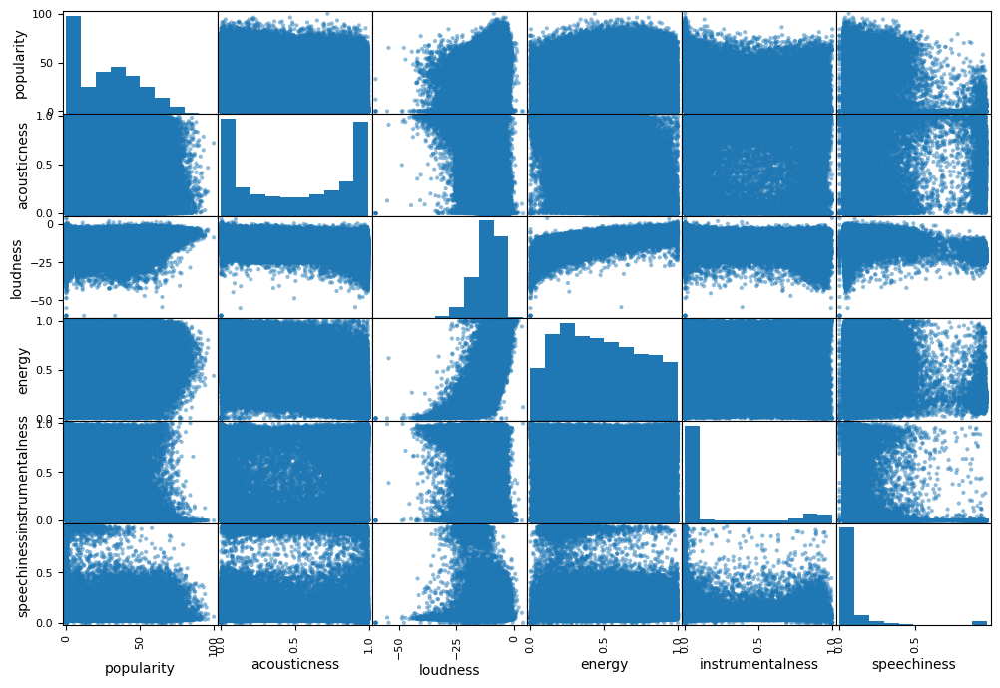

In [ ]:
from pandas.plotting import scatter_matrix
attributes = ['popularity', 'acousticness', 'loudness', 'energy', 'instrumentalness', 'speechiness']
axes = scatter_matrix(train[attributes], figsize=(12, 8))

The top 3 most highly correlated attributes with popularity are acousticness, loudness, and energy, so they are the most promising predictors of song popularity. Thus, we need to examine their scatterplots with popularity more closely for any data quirks.

In [ ]:
ac = train[["acousticness", "popularity"]]

alt.Chart(ac).mark_point().encode(
    x=alt.X("acousticness:Q"),
    y=alt.Y("popularity:Q")
)

alt.Chart(...)

Just like the correlation matrix told us, we observe that there is a very weak, negative, and possibly linear relationship between acousticness and popularity. The maximum popularity does seem to decrease as acousticness increases.

In [ ]:
energy = train[["energy", "popularity"]]

alt.Chart(energy).mark_point().encode(
    x=alt.X("energy:Q"),
    y=alt.Y("popularity:Q")
)

alt.Chart(...)

From the chart, we see that popularity has a weak, positive correlation with energy, consistent with the correlation coefficient from the correlation matrix. The maximum popularity tends to increase as energy increases until the energy reaches around .6 or .7. From there, as energy increases, the maximum popularity decreases.

In [ ]:
loud = train[["loudness", "popularity"]]

alt.Chart(loud).mark_point().encode(
    x=alt.X("loudness:Q"),
    y=alt.Y("popularity:Q")
)

alt.Chart(...)

We observe that the relationship between loudness and popularity is weakly positive and possibly linear. This relationship is consistent with the correlation we found from the correlation matrix. As loudness increases, the maximum popularity generally increases. Additionally, we see that there are some potential outliers in the x direction.

### Processing the Data

Before we start training our models, we need to process our data and split the training set into the features and the labels.

In [ ]:
train_X = train.drop("popularity", axis=1)
train_Y = train["popularity"].copy()
train_X_before_transform = train_X.copy() # make a copy for lime charts with normal columns

To prepare our data for training, we scale our numerical attributes and encode our categorical attributes. We note that we did try log transformations on the columns with skewed distributions, but performance was not improved significantly. As such, we will continue with this pipeline for simplicity.

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

num_attribs = ['acousticness', 'danceability', 'energy', 'tempo', 'valence', 'loudness', 'duration_ms', 'instrumentalness', 'liveness', 'speechiness']
cat_attribs = ['explicit', 'key', 'mode']

num_pipeline = Pipeline([
        ('std_scaler', StandardScaler()),
])

encoder = OneHotEncoder()

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", encoder, cat_attribs)
])

train_X = full_pipeline.fit_transform(train_X)

Let's extract feature names from the pipeline after one hot encoding on categorical variables since these are the features we trained on.

In [ ]:
import warnings

# from https://johaupt.github.io/scikit-learn/tutorial/python/data%20processing/ml%20pipeline/model%20interpretation/columnTransformer_feature_names.html
def get_feature_names(column_transformer):
    """Get feature names from all transformers.
    Returns
    -------
    feature_names : list of strings
        Names of the features produced by transform.
    """
    # Remove the internal helper function
    #check_is_fitted(column_transformer)
    
    # Turn loopkup into function for better handling with pipeline later
    def get_names(trans):
        # >> Original get_feature_names() method
        if trans == 'drop' or (
                hasattr(column, '__len__') and not len(column)):
            return []
        if trans == 'passthrough':
            if hasattr(column_transformer, '_df_columns'):
                if ((not isinstance(column, slice))
                        and all(isinstance(col, str) for col in column)):
                    return column
                else:
                    return column_transformer._df_columns[column]
            else:
                indices = np.arange(column_transformer._n_features)
                return ['x%d' % i for i in indices[column]]
        if not hasattr(trans, 'get_feature_names'):
        # >>> Change: Return input column names if no method avaiable
            # Turn error into a warning
            warnings.warn("Transformer %s (type %s) does not "
                                 "provide get_feature_names. "
                                 "Will return input column names if available"
                                 % (str(name), type(trans).__name__))
            # For transformers without a get_features_names method, use the input
            # names to the column transformer
            if column is None:
                return []
            else:
                return [name + "__" + f for f in column]

        return [name + "__" + f for f in trans.get_feature_names()]
    
    ### Start of processing
    feature_names = []
    
    # Allow transformers to be pipelines. Pipeline steps are named differently, so preprocessing is needed
    if type(column_transformer) == Pipeline:
        l_transformers = [(name, trans, None, None) for step, name, trans in column_transformer._iter()]
    else:
        # For column transformers, follow the original method
        l_transformers = list(column_transformer._iter(fitted=True))
    
    
    for name, trans, column, _ in l_transformers: 
        if type(trans) == Pipeline:
            # Recursive call on pipeline
            _names = get_feature_names(trans)
            # if pipeline has no transformer that returns names
            if len(_names)==0:
                _names = [name + "__" + f for f in column]
            feature_names.extend(_names)
        else:
            feature_names.extend(get_names(trans))
    
    return feature_names

model_features = get_feature_names(full_pipeline)
model_features

/shared-libs/python3.7/py-core/lib/python3.7/site-packages/ipykernel_launcher.py:36: UserWarning: Transformer std_scaler (type StandardScaler) does not provide get_feature_names. Will return input column names if available


['num__acousticness',
 'num__danceability',
 'num__energy',
 'num__tempo',
 'num__valence',
 'num__loudness',
 'num__duration_ms',
 'num__instrumentalness',
 'num__liveness',
 'num__speechiness',
 'cat__x0_0',
 'cat__x0_1',
 'cat__x1_0',
 'cat__x1_1',
 'cat__x1_2',
 'cat__x1_3',
 'cat__x1_4',
 'cat__x1_5',
 'cat__x1_6',
 'cat__x1_7',
 'cat__x1_8',
 'cat__x1_9',
 'cat__x1_10',
 'cat__x1_11',
 'cat__x2_0',
 'cat__x2_1']

Looking at the categorical variables, we can see our categorical variables have been mapped as follows:
- `cat__x0`: Explicit content (0=No Explicit, 1=Contains Explicit)
- `cat__x1`: Key (0:C, 1:C#, 2:D, ..., 11:B)
- `cat__x2`: Mode (0=Minor Track, 1=Major Track)

### Modeling

In order to predict song popularity from the audio features of a song, we need to try various regression models and then compare performance to find the best model. We will try linear regression, decision trees, random forest, and k-nearest neighbors and measure performance by root mean square error.

##### Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(train_X, train_Y)

LinearRegression()

In [ ]:
from sklearn.metrics import mean_squared_error
import numpy as np

train_X_pred = lin_reg.predict(train_X)
lin_mse = mean_squared_error(train_Y, train_X_pred)
lin_rmse = np.sqrt(lin_mse)
lin_rmse

18.206099806786497

We see that the root mean square error is quite high considering popularity ranges from 0 to 100.

##### Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeRegressor

tree_reg = DecisionTreeRegressor()
tree_reg.fit(train_X, train_Y)

DecisionTreeRegressor()

In [ ]:
train_X_pred = tree_reg.predict(train_X)
tree_mse = mean_squared_error(train_Y, train_X_pred)
tree_rmse = np.sqrt(tree_mse)
tree_rmse

1.386818452084289

Our decision tree error is significantly improved over linear regression. However, given that the error is extremely small, we are concerned there may be overfitting.

##### Random Forest

In [ ]:
# WARNING: runs slow
from sklearn.ensemble import RandomForestRegressor

forest_reg = RandomForestRegressor()
forest_reg.fit(train_X, train_Y)

RandomForestRegressor()

In [ ]:
train_X_pred = forest_reg.predict(train_X)
forest_mse = mean_squared_error(train_Y, train_X_pred)
forest_rmse = np.sqrt(forest_mse)
forest_rmse

6.015728067425471

Like the decision tree error, our random forest error is significantly improved over linear regression.

##### K-Nearest Neighbors

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

neigh = KNeighborsRegressor(n_neighbors=2)
neigh.fit(train_X, train_Y)

KNeighborsRegressor(n_neighbors=2)

In [ ]:
train_X_pred = neigh.predict(train_X)
neigh_mse = mean_squared_error(train_Y, train_X_pred)
neigh_rmse = np.sqrt(neigh_mse)
neigh_rmse

11.2000023345754

We observe that the rmse for the k-nearest neighbors model is also improved over linear regression, but the error is still relatively high considering popularity ranges from 0 to 100.

##### K-fold Cross Validation

To get a better sense of how each of the models perform, we use k-fold cross validation. We examine each model's ability to predict new data that was not used in training the model in order to check for problems like overfitting, which we saw potentially in the decision tree rmse.

In [ ]:
def display_scores(scores):
    '''
    Takes a numpy array of cross validation scores and prints
    the array of scores, the mean, and the standard deviation.
    '''
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

First, we examine the linear regression model and see that the mean of the rmse scores is about 18, which is consistent with the rmse we found earlier.

In [ ]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(lin_reg, train_X, train_Y,
                         scoring="neg_mean_squared_error", cv=5)
lin_rmse_scores = np.sqrt(-scores)
display_scores(lin_rmse_scores)

Scores: [18.25278364 18.19564306 18.24315993 18.25783553 18.0988148 ]
Mean: 18.209647393506835
Standard deviation: 0.05964211150716387


Next, we check the performance of the decision tree regression model and observe that the mean of the rmse scores is higher than that for the linear regression model.

In [ ]:
scores = cross_val_score(tree_reg, train_X, train_Y,
                         scoring="neg_mean_squared_error", cv=5)
tree_rmse_scores = np.sqrt(-scores)
display_scores(tree_rmse_scores)

Scores: [22.50346837 22.28675977 22.44922423 22.57948285 22.33867138]
Mean: 22.43152132044637
Standard deviation: 0.10673275121223837


Looking at the k-fold cross valdiation results for the random forest regression model, we find that this model had the lowest mean for rmse scores out of the models checked so far.

In [ ]:
scores = cross_val_score(forest_reg, train_X, train_Y,
                         scoring="neg_mean_squared_error", cv=5)
forest_rmse_scores = np.sqrt(-scores)
display_scores(forest_rmse_scores)

Scores: [15.95117669 15.8674807  15.80772312 15.88498864 15.70467395]
Mean: 15.843208620951803
Standard deviation: 0.0829974497623131


With the k-nearest neighbors regression model, the mean of the rmse scores is higher than that of the random forest regression model and the linear regression model, but is lower than the mean of the rmse scores for the decision tree model.

In [ ]:
scores = cross_val_score(neigh, train_X, train_Y,
                         scoring="neg_mean_squared_error", cv=5)
k_rmse_scores = np.sqrt(-scores)
display_scores(k_rmse_scores)

Scores: [19.76086982 19.66816657 19.64711846 19.70965782 19.71788216]
Mean: 19.700738965806128
Standard deviation: 0.0398127490882775


After evaluating each of our models using k-fold cross validation, we find that the random forest regression model had the best performance out of all of the models. As such, we will continue with this model for fine tuning.

### Fine Tuning the Model

Note: This section is commented out as fine tuning the model was highly inefficient / time consuming and did not significantly improve the model.

In [ ]:
# WARNING: runs VERY slow
#from sklearn.model_selection import GridSearchCV

#param_grid = [
#    {'n_estimators': [10, 50, 100], 'max_features': [6, 8, 10, 12]},
#    {'bootstrap': [False], 'n_estimators': [50, 100], 'max_features': [6, 8, 10]},
#  ]

#forest_reg_grid = RandomForestRegressor()

# grid_search = GridSearchCV(forest_reg_grid, param_grid, cv=5,
#                           scoring='neg_mean_squared_error',
#                           return_train_score=True)

# grid_search.fit(train_X, train_Y)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid=[{'max_features': [6, 8, 10, 12],
                          'n_estimators': [10, 50, 100]},
                         {'bootstrap': [False], 'max_features': [6, 8, 10],
                          'n_estimators': [50, 100]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [ ]:
# grid_search.best_params_

{'max_features': 10, 'n_estimators': 100}

In [ ]:
#scores = cross_val_score(grid_search.best_estimator_, train_X, train_Y,
#                         scoring="neg_mean_squared_error", cv=5)
# forest_grid_rmse_scores = np.sqrt(-scores)
# display_scores(forest_grid_rmse_scores)

Scores: [15.81416593 15.8110661  15.63937733 15.65544837 15.74711251]
Mean: 15.733434048136791
Standard deviation: 0.07437728561679267


Examining the error for the best grid searched random forest regressor model, we see that the mean of the rmse scores did decrease from earlier (from 15.84 to 15.73), although by a small amount. Given the complexity and time it takes to run this grid search as well as the minor improvement, we decide to stick with the original RandomForestRegressor.

We note that we also tried taking the 10 most important features and using only them in our model, but the performance did not significantly change.

In [ ]:
# feature_importances = grid_search.best_estimator_.feature_importances_
# cat_encoder = full_pipeline.named_transformers_["cat"]
# cat_one_hot_attribs = []
# for category_num in range(len(cat_encoder.categories_)):
#     for feature_num in cat_encoder.categories_[category_num]:
#         cat_one_hot_attribs.append("cat__x" + str(category_num) + "_" + str(feature_num))
# attributes = num_attribs + cat_one_hot_attribs
# sorted_importances = sorted(zip(attributes, map(lambda x: round(x, 4), feature_importances)), reverse=True, key=lambda y: y[1])
# pd.DataFrame(sorted_importances, columns=['Feature', 'Importance'])

,Feature,Importance
0,acousticness,0.1970
1,energy,0.1027
2,loudness,0.1007
3,speechiness,0.0996
4,instrumentalness,0.0992
5,duration_ms,0.0867
6,danceability,0.0625
7,valence,0.0602
8,tempo,0.0570
9,liveness,0.0551


We do see that acousticness, energy, and loudness are the top 3 attributes in terms of feature importance, with acousticness almost twice as important as the next most important feature. 

Based on the output above, we tried another random forest regressor with the best parameters we found with Grid Search and only the top 10 most important features.

In [ ]:
# # from https://github.com/ageron/handson-ml2/blob/master/02_end_to_end_machine_learning_project.ipynb
# from sklearn.base import BaseEstimator, TransformerMixin

# def indices_of_top_k(arr, k):
#     return np.sort(np.argpartition(np.array(arr), -k)[-k:])

# class TopFeatureSelector(BaseEstimator, TransformerMixin):
#     def __init__(self, feature_importances, k):
#         self.feature_importances = feature_importances
#         self.k = k
#     def fit(self, X, y=None):
#         self.feature_indices_ = indices_of_top_k(self.feature_importances, self.k)
#         return self
#     def transform(self, X):
#         return X[:, self.feature_indices_]

In [ ]:
# import numpy as np

# k = 10
# feature_selection_pipeline = Pipeline([
#     ('preparation', full_pipeline),
#     ('feature_selection', TopFeatureSelector(feature_importances, k))
# ])

In [ ]:
# train_X = train.drop("popularity", axis=1)
# train_X_feat_select = feature_selection_pipeline.fit_transform(train_X)

In [ ]:
# best_estimator_top_features = grid_search.best_estimator_
# best_estimator_top_features.fit(train_X_feat_select, train_Y)

RandomForestRegressor(max_features=10)

In [ ]:
# scores = cross_val_score(best_estimator_top_features, train_X, train_Y,
#                          scoring="neg_mean_squared_error", cv=5)
# best_top_rmse_scores = np.sqrt(-scores)
# display_scores(best_top_rmse_scores)

Scores: [15.84102559 15.83817516 15.71092374 15.73278837 15.8224181 ]
Mean: 15.789066193072042
Standard deviation: 0.05567271548847083


This wasn't an improvement over the grid searched model with all the features included. To see if a slightly wider set of features helps, we also tried selecting the top 15 features instead of the top 10. Note that we couldn't select a smaller number of features due to the max_features constraint of our model.

In [ ]:
# k = 15
# feature_selection_pipeline = Pipeline([
#     ('preparation', full_pipeline),
#     ('feature_selection', TopFeatureSelector(feature_importances, k))
# ])

In [ ]:
# train_X = train.drop("popularity", axis=1)
# train_X_feat_select = feature_selection_pipeline.fit_transform(train_X)

In [ ]:
# best_estimator_top_features_more_feat = grid_search.best_estimator_
# best_estimator_top_features_more_feat.fit(train_X_feat_select, train_Y)

RandomForestRegressor(max_features=10)

In [ ]:
# scores = cross_val_score(best_estimator_top_features, train_X, train_Y,
#                          scoring="neg_mean_squared_error", cv=5)
# best_top_rmse_scores = np.sqrt(-scores)
# display_scores(best_top_rmse_scores)

Scores: [15.84518019 15.8500981  15.69779976 15.73124175 15.81756294]
Mean: 15.788376547926877
Standard deviation: 0.062219916324006495


This model with the top 15 features wasn't an improvement either. As a result, we decide to stick with the original model as our best model based on it having the lowest root mean square error compared to the feature selection models and it being much more efficient to use than the grid searched model.

### Evaluating Our Chosen Model

Taking the original random forest regressor model, we evaluate it on the test data set.

In [ ]:
best_model = forest_reg

test_X = test.drop("popularity", axis=1)
test_Y = test["popularity"].copy()

test_X = full_pipeline.transform(test_X)
pred = best_model.predict(test_X)

final_mse = mean_squared_error(test_Y, pred)
final_rmse = np.sqrt(final_mse)
final_rmse

15.758247622879434

We find that our chosen model does slightly better with test data than with kfold cross validation on the training set! It clearly outperforms any of the other models we tested on the training set and is even comparable to the grid searched model that was highly inefficient.

### Determining Contribution of Features in Prediction

In [ ]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(np.array(test_X),
                    feature_names=model_features,
                    class_names=['popularity'], 
                    categorical_features=cat_attribs, 
                    verbose=True, mode='regression')

Now let's look at a couple songs and see what made them popular or not. Let's start with an unpopular song.

In [ ]:
exp = explainer.explain_instance(test_X[196], best_model.predict) # test_X uses index in numpy array to access values (also TODO: change to best model)
exp.show_in_notebook(show_table=True, show_all=False)
print("Actual popularity: ", test_Y.get(4630)) # test_Y uses actual index to access values (which is why it looks like a discrepancy)

Intercept 32.337215505511494
Prediction_local [11.45882391]
Right: 2.315


Actual popularity:  0


The model does well to correctly identify that this is a highly unpopular song. The most influential features for this song were all negative. Here are a few features and their explanations:
- Acousticness: Being highly acoustic (1.31) hurt popularity a lot.
- Instrumentalness: Being highly instrumental (2.09) hurt popularity as well.
- Explicit: The categorical feature cat__x0_1 represents whether the song is explicit. This was not an explicit song, which is unpopular according to the model.
- Danceability: Being not very danceable (-1.23) hurt popularity.

Now let's try a popular song.

In [ ]:
exp = explainer.explain_instance(test_X[170], best_model.predict)
exp.show_in_notebook(show_table=True, show_all=False)
print("Actual popularity: ", test_Y[38844])

Intercept 20.78970426048698
Prediction_local [36.57369987]
Right: 58.55


Actual popularity:  75


For this highly popular song, the model does not pinpoint the exact degree of popularity, but does quite well to identify this as one of the highest popularity songs (going back to our EDA distribution where there are very few songs 70+ in popularity). The reason why the model is so confident in predicting this song as popular is that for the most influential features, it is in the positive popularity range. 
Here's a few features and their explanations:
- Acousticness: Having neutral acousticness (-0.14) is enough to help popularity significantly.
- Explicit: The categorical feature `cat__x0_1` represents whether the song is explicit. In this case being explicit gives a big boost to popularity.
- Speechiness: This song being slightly low in speechiness (-0.44) is a positive.
- Danceability: The song having neutral danceability (-0.16) is actually a negative for its popularity!

In [ ]:
feature_importances = best_model.feature_importances_
cat_encoder = full_pipeline.named_transformers_["cat"]
cat_one_hot_attribs = []
for category_num in range(len(cat_encoder.categories_)):
    for feature_num in cat_encoder.categories_[category_num]:
        cat_one_hot_attribs.append("cat__x" + str(category_num) + "_" + str(feature_num))
attributes = num_attribs + cat_one_hot_attribs
sorted_importances = sorted(zip(attributes, map(lambda x: round(x, 4), feature_importances)), reverse=True, key=lambda y: y[1])
pd.DataFrame(sorted_importances, columns=['Feature', 'Importance'])

,Feature,Importance
0,acousticness,0.2574
1,speechiness,0.1296
2,instrumentalness,0.0958
3,duration_ms,0.0796
4,loudness,0.0752
5,valence,0.0640
6,danceability,0.0617
7,tempo,0.0586
8,energy,0.0553
9,liveness,0.0543


In our final model, acousticness, speechiness, instrumentalness, duration, and loudness were the five most important features, with acousticness twice as important for popularity as the rest! From our EDA we saw that four of these five features were all within the top 5 most correlated features with popularity as well. 

With the Lime Charts, we saw that the model picked up on these correlations. A positive acousticness of 1.31 was heavily negative and a neutral acousticness of -0.14 was very positive for popularity. Speechiness also seemed to negatively impact popularity according to the model while loudness positively impacted popularity. Explicit songs were the strongest categorical feature contributing to positive popularity, while other categorical features were less impactful.

### Results

We successfully trained a Random Forest Regressor model to predict popularity. It was able to predict popularity (from 0 to 100) with a root mean squared error of approximately 15.75 on our test data set. While this isn't perfect, predicting song popularity and working with real world data can be difficult, so our outcome is quite good! In particular, our model seemed to struggle with predicting very high popularity data (not predicting popularities over 60) which contributed to its error. Nonetheless, we had recognized this as a concern with our initial EDA given the imbalanced dataset containing more unpopular songs than popular songs. Moreover, we recognized through this process that it's difficult to predict a hit!

By looking at our model's feature importances, we found that acousticness was by far the largest contributor to song popularity. Highly acoustic songs hurt popularity while even neutrally acoustic songs were enough to significantly boost popularity. Other features picked up as important by the model included speechiness, where slightly less speechiness is positive, and instrumentalness, where the model found that highly instrumental songs can hurt popularity. One thing to note with these conclusions are that these are based off the way the model was trained and shouldn't be exact rules. But one thing that can be learned is that audio features of a song are a spectrum. A 0.80 and a -1.02 tempo are both positive for popularity, but too much in either way might not help. But if there is one categorical feature of a song that can be easily changed to increase popularity to the model, it would be making a song explicit. Overall, the exact feature impact on popularity should be taken with a grain of salt, but we can recommend that from both correlations and the model that acousticness, speechiness, instrumentalness, loudness, and energy should be given the most attention when trying to identify a hit. 

With these results, we are able to provide insight as to what may determine a song's popularity on Spotify. Such knowledge can guide record labels or artists in the song writing and production process so that they can make a popular and thus commercially successful hit. By understanding what audio features can help predict popularity, record labels and artists can more efficiently boost their popularity on streaming platforms like Spotify and such popularity in streaming could also translate into radio airplay and awards, bringing futher commercial success and recognition to artists.

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=a7dfec2a-9aa3-4b6b-b099-4ed2a76158cc' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>